In [49]:
%pip install ultralytics

import torch
print(torch.__version__)

import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.0.208 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15110MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5122.5/8062.4 GB disk)


In [56]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns
import glob
import shutil
import torchvision

from torchvision.io import read_image
from torchvision.utils import draw_bounding_boxes
from shutil import copyfile
from pathlib import Path
from tqdm import tqdm
from sklearn.model_selection import train_test_split
from PIL import Image, ImageDraw, ImageFont
from PIL import __version__ as pil_version
# from ultralytics.yolo.utils import LOGGER, TryExcept, plt_settings, threaded
# from ultralytics.yolo.utils.plotting import *
from scipy.ndimage import gaussian_filter1d

import numpy as np
from PIL import Image
import requests
from io import BytesIO
import cv2

%matplotlib inline

# Hyperparameter options

In [77]:
TRAIN_PATH = '/kaggle/input/global-wheat-detection/train/'
TEST_PATH = '/kaggle/input/global-wheat-detection/test/'
IMG_SIZE = 1024
BATCH_SIZE = 16
EPOCHS = 3

# Prepare Dataset

In [11]:
%cd ../

df = pd.read_csv('/kaggle/input/global-wheat-detection/train.csv')
df['path'] = df.apply(lambda row: TRAIN_PATH+row.image_id+'.jpg', axis=1)
df.head()

/


,image_id,width,height,bbox,source,path
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...


In [12]:
def display_images(df):
    # set up the canvas for the subplots
    plt.figure(figsize=(30,30))
    j = 1
    for i in range(0,900,100):
        # Load an image
        image = plt.imread(df.path[i])
        
        #image = cv2.resize(image, (IMAGE_SIZE, IMAGE_SIZE))
        plt.subplot(3,3,j)
        j+=1
        plt.imshow(image)
        plt.axis('off')

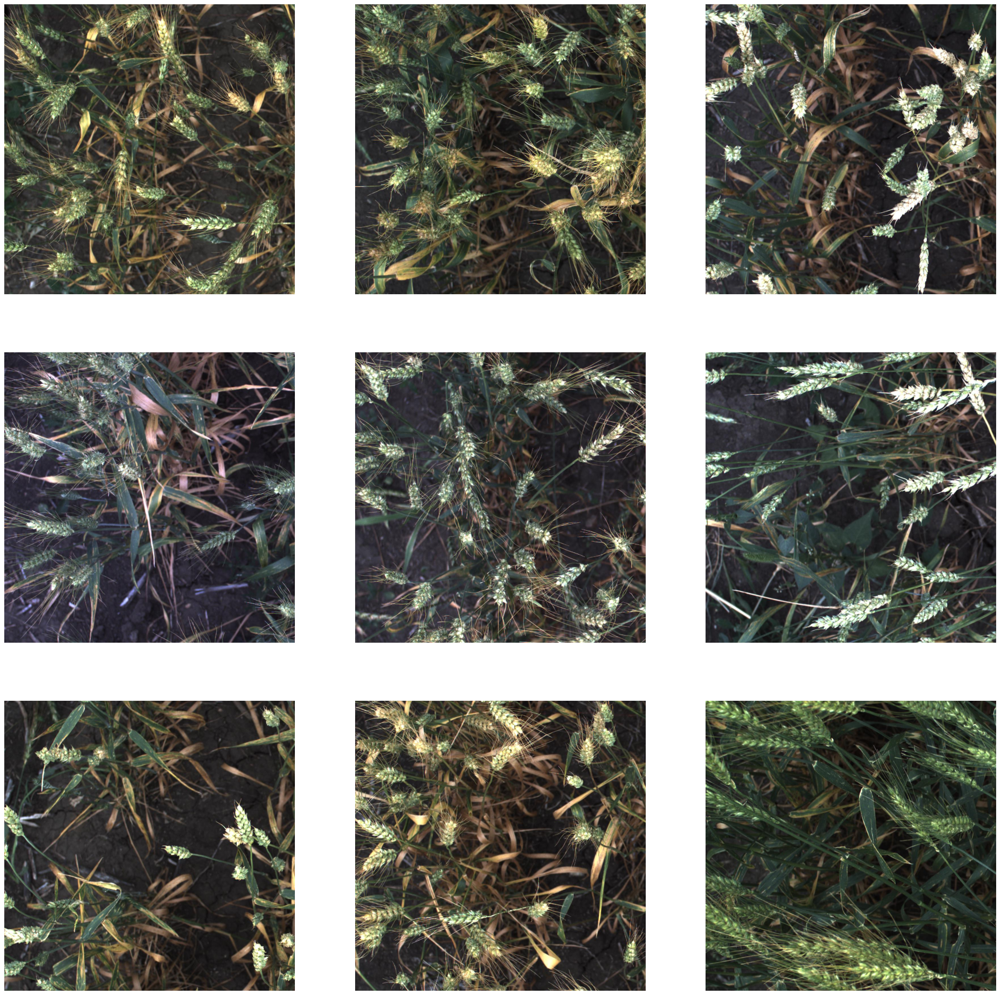

In [13]:
display_images(df)

# Train-validation split

In [14]:
train_list, valid_list = train_test_split(df.image_id.unique(), test_size=0.2, random_state=1)

In [15]:
len(train_list)

2698

In [16]:
len(valid_list)

675

In [17]:
train_df = df.loc[df.image_id.isin(train_list)]
valid_df = df.loc[df.image_id.isin(valid_list)]

train_df.loc[:, 'split'] = 'train'
valid_df.loc[:, 'split'] = 'valid'

df = pd.concat([train_df, valid_df]).reset_index(drop=True)

/tmp/ipykernel_32/4127551595.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df.loc[:, 'split'] = 'train'
/tmp/ipykernel_32/4127551595.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid_df.loc[:, 'split'] = 'valid'


In [18]:
len(train_df), len(valid_df)

(117750, 30043)

In [19]:
df

,image_id,width,height,bbox,source,path,split
0,b6ab77fd7,1024,1024,"[834.0, 222.0, 56.0, 36.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...,train
1,b6ab77fd7,1024,1024,"[226.0, 548.0, 130.0, 58.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...,train
2,b6ab77fd7,1024,1024,"[377.0, 504.0, 74.0, 160.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...,train
3,b6ab77fd7,1024,1024,"[834.0, 95.0, 109.0, 107.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...,train
4,b6ab77fd7,1024,1024,"[26.0, 144.0, 124.0, 117.0]",usask_1,/kaggle/input/global-wheat-detection/train/b6a...,train
...,...,...,...,...,...,...,...
147788,a5c8d5f5c,1024,1024,"[473.0, 637.0, 62.0, 67.0]",arvalis_2,/kaggle/input/global-wheat-detection/train/a5c...,valid
147789,a5c8d5f5c,1024,1024,"[980.0, 207.0, 44.0, 84.0]",arvalis_2,/kaggle/input/global-wheat-detection/train/a5c...,valid
147790,a5c8d5f5c,1024,1024,"[568.0, 348.0, 123.0, 94.0]",arvalis_2,/kaggle/input/global-wheat-detection/train/a5c...,valid
147791,a5c8d5f5c,1024,1024,"[10.0, 806.0, 64.0, 92.0]",arvalis_2,/kaggle/input/global-wheat-detection/train/a5c...,valid


In [20]:
print(f'Size of dataset: {len(df)}, training images: {len(train_df)}. validation images: {len(valid_df)}')

Size of dataset: 147793, training images: 117750. validation images: 30043


In [ ]:
%cd ../../
%cd /kaggle/working/

os.makedirs('dataset/images/train', exist_ok=True)
os.makedirs('dataset/images/valid', exist_ok=True)
os.makedirs('dataset/images/test', exist_ok=True)

os.makedirs('dataset/labels/train', exist_ok=True)
os.makedirs('dataset/labels/valid', exist_ok=True)
os.makedirs('dataset/labels/test', exist_ok=True)

%cd ../../
!tree kaggle/working/dataset

In [23]:
# Move the images to relevant split folder.
for i in tqdm(range(len(df))):
    row = df.loc[i]
    if row.split == 'train':
        copyfile(row.path, f'kaggle/working/dataset/images/train/{row.image_id}.jpg')
    else:
        copyfile(row.path, f'kaggle/working/dataset/images/valid/{row.image_id}.jpg')

100%|██████████| 147793/147793 [04:35<00:00, 536.99it/s]


In [24]:
# Move the test images to relevant split folder.
# paths
src = 'kaggle/input/global-wheat-detection/test'
trg = 'kaggle/working/dataset/images/test'

files=os.listdir(src)

# iterating over all the files in
# the source directory
for fname in files:
    # copying the files to the
    # destination directory
    shutil.copy2(os.path.join(src,fname), trg)

# Create `.YAML` file

In [25]:
%cd kaggle/working/

/kaggle/working


In [26]:
%%writefile dataset.yaml
path: ../../../../../kaggle/working/dataset
train: images/train
val: images/valid
test: images/test

# Classes
names:
    0: none
    1: wheat

Writing dataset.yaml


In [27]:
%cat dataset.yaml

path: ../../../../../kaggle/working/dataset
train: images/train
val: images/valid
test: images/test

# Classes
names:
    0: none
    1: wheat


# Prepare Bounding Box Coordinated for YOLOv8

In [28]:
def get_bbox(row):
    bboxes = []
    bbox = []
    list1 = row.bbox.replace("[", "").replace("]","").replace(",","")
    for i in list1.split(" "):
        bboxes.append(float(i))
    return bboxes

In [29]:
# Convert the bounding boxes in YOLO format.
def get_yolo_format_bbox(img_w, img_h, bboxes):
    yolo_boxes = []
    x = bboxes[0]
    y = bboxes[1]
    w = bboxes[2] 
    h = bboxes[3] 
    xc = x + int(w/2) # xmin + width/2
    yc = y + int(h/2) # ymin + height/2
    yolo_boxes=[1, xc/img_w, yc/img_h, w/img_w, h/img_h] # x_center y_center width height
    yolo_boxes = str(yolo_boxes).replace("[", "").replace("]","").replace(",","")
    return yolo_boxes

In [30]:
# Prepare the txt files for bounding box
for i in tqdm(range(len(df))):
    row = df.loc[i]
    # Get image id
    img_id = row.image_id
    # Get split
    split = row.split
    
    if row.split=='train':
        file_name = f'dataset/labels/train/{row.image_id}.txt'
    else:
        file_name = f'dataset/labels/valid/{row.image_id}.txt'
        
    bboxes = get_bbox(row)
        
    # Format for YOLOv5
    yolo_bboxes = get_yolo_format_bbox(IMG_SIZE, IMG_SIZE, bboxes)
        
    with open(file_name, 'a') as f:
        f.write(yolo_bboxes)
        f.write('\n')
    #print(file_name)
    #print(yolo_bboxes)

100%|██████████| 147793/147793 [00:34<00:00, 4345.44it/s]


In [31]:
TRAIN_PATH = 'dataset/images/train'
TRAIN_LABEL_PATH = 'dataset/labels/train'

In [32]:
train_files = os.listdir(TRAIN_LABEL_PATH)
print('Number of test images predicted as wheat: ', len(train_files))

Number of test images predicted as wheat:  2698


In [33]:
def display_images_with_box(num):
    pred = []
    bbox = []
    image_id = []
    k = 1
    plt.figure(figsize=(30,30))
    for i in train_files[:num]:
        with open(f'{TRAIN_LABEL_PATH}/{i}') as f:
            img = read_image(f'{TRAIN_PATH}/{i[:-4]}.jpg')
            bbox = []
            for j in f:
                pred = i[:-4] + " " + j[:-1]
                pred = pred.split(" ")
                pred.pop(0)
                pred.pop(0)
                pred = [eval(i) for i in pred]
                pred = [i*1024 for i in pred]
                [x, y, w, h] = pred
                [xmin, ymin, xmax, ymax] = [x-w/2, y-h/2, x+w/2, y+h/2,]
                pred = [xmin, ymin, xmax, ymax]
                bbox.append(pred)
            bbox = torch.tensor(bbox, dtype=torch.int)
            img = draw_bounding_boxes(img, bbox, width=10,colors=(255,0,0))
            img = torchvision.transforms.ToPILImage()(img)
            plt.subplot(num//3+num%3,3,k)
            k+=1
            plt.imshow(img)
            plt.axis('off')

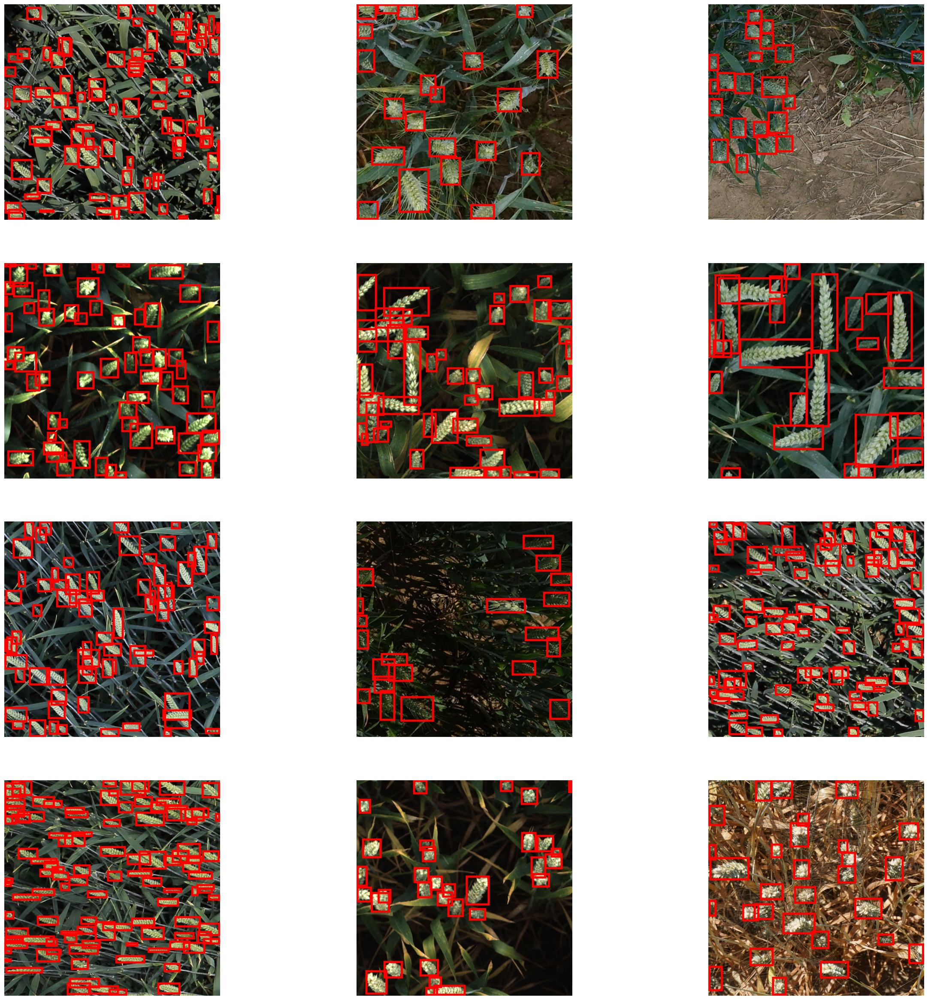

In [34]:
display_images_with_box(12)

# Train with YOLOv8

In [35]:
%cd ../../../
%cd kaggle/working/

/
/kaggle/working


In [ ]:
model = YOLO("yolov8n.yaml") 

In [37]:
! rm -rf /kaggle/working/runs

In [ ]:
# !wandb off
model.train(data='dataset.yaml', epochs=EPOCHS, imgsz=IMG_SIZE, batch=BATCH_SIZE, save_period=1, cls=7,device=[0,1], name="auto_default")

In [ ]:
model.train(data='dataset.yaml', epochs=EPOCHS, imgsz=IMG_SIZE, batch=BATCH_SIZE, save_period=1, cls=7, device=[0,1],optimizer='SGD', momentum=0.8, close_mosaic=0, name="sgd_noaug" )

In [81]:
model.train(data='dataset.yaml', epochs=EPOCHS, imgsz=IMG_SIZE, batch=BATCH_SIZE, save_period=1, cls=7, device=[0,1],optimizer='Adam', momentum=0.95, close_mosaic=10, name="adam_aug" )

        1/3         4G      2.656      28.42      2.602        216       1024: 100%|██████████| 169/169 [02:07<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 43/43 [01:04<00:00,  1.49s/it]
                   all        675      30043      0.467      0.424      0.413      0.151

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
        2/3      3.72G      2.197      22.98      2.069        200       1024: 100%|██████████| 169/169 [01:58<00:00,  1.42it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 43/43 [01:02<00:00,  1.45s/it]
                   all        675      30043      0.664      0.594      0.627      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size
        3/3      4.44G      2.073      20.65      1.982        121       1024: 100%|██████████| 169/169 [01:57<00:00,  1.44it/s]
 

# Evaluation

### Copy somefile for later use:

In [53]:
df = pd.read_csv('/kaggle/working/runs/detect/sgd_noaug/results.csv')
df.head()

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,4.0489,39.177,4.1979,0.28106,0.33941,0.21763,0.06284,3.1827,29.594,3.9004,0.003314,0.003314,0.003314


In [52]:
df = pd.read_csv('/kaggle/working/runs/detect/train/results.csv')
df.head()


,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,3.2268,34.655,3.4266,0.34617,0.42076,0.2925,0.0981,2.5537,29.368,2.6829,0.000552,0.000552,0.000552


In [76]:
df = pd.read_csv('/kaggle/working/runs/detect/adam_aug/results.csv')
df.head()

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,2.6214,26.499,2.4549,0.56619,0.51586,0.51954,0.17224,2.445,40.758,2.3536,0.070178,0.003314,0.003314


# Prediction

In [58]:
TEST_PATH = 'dataset/images/test'

In [59]:
MODEL_PATH = 'runs/detect/train/weights/best.pt'

In [60]:
model = YOLO(MODEL_PATH)

In [ ]:
model.predict(source=TEST_PATH, imgsz=IMG_SIZE, conf=0.5, iou=0.6, save_txt=True, save_conf=True);

In [62]:
%cd ../../../
%cd kaggle/working/

/
/kaggle/working


In [63]:
PRED_PATH = 'runs/detect/predict/labels'
!ls {PRED_PATH}

2fd875eaa.txt  51b3e36ab.txt  53f253011.txt  aac893a91.txt
348a992bb.txt  51f1be19e.txt  796707dd7.txt  cc3532ff6.txt


In [64]:
prediction_files = os.listdir(PRED_PATH)
print('Number of test images predicted as opaque: ', len(prediction_files))

Number of test images predicted as opaque:  8


In [65]:
def display_preds_with_box(num):
    pred = []
    bbox = []
    image_id = []
    k = 1
    plt.figure(figsize=(30,30))
    for i in prediction_files[:num]:
        with open(f'{PRED_PATH}/{i}') as f:
            img = read_image(f'{TEST_PATH}/{i[:-4]}.jpg')
            bbox = []
            for j in f:
                pred = i[:-4] + " " + j[:-1]
                pred = pred.split(" ")
                pred.pop(0)
                pred.pop(0)
                pred.pop(-1)
                pred = [eval(i) for i in pred]
                pred = [i*1024 for i in pred]
                [x, y, w, h] = pred
                [xmin, ymin, xmax, ymax] = [x-w/2, y-h/2, x+w/2, y+h/2]
                pred = [xmin, ymin, xmax, ymax]
                bbox.append(pred)
            bbox = torch.tensor(bbox, dtype=torch.int)
            img = draw_bounding_boxes(img, bbox, width=10,colors=(255,0,0))
            img = torchvision.transforms.ToPILImage()(img)
            plt.subplot(num//3+num%3,3,k)
            k+=1
            plt.imshow(img)
            plt.axis('off')

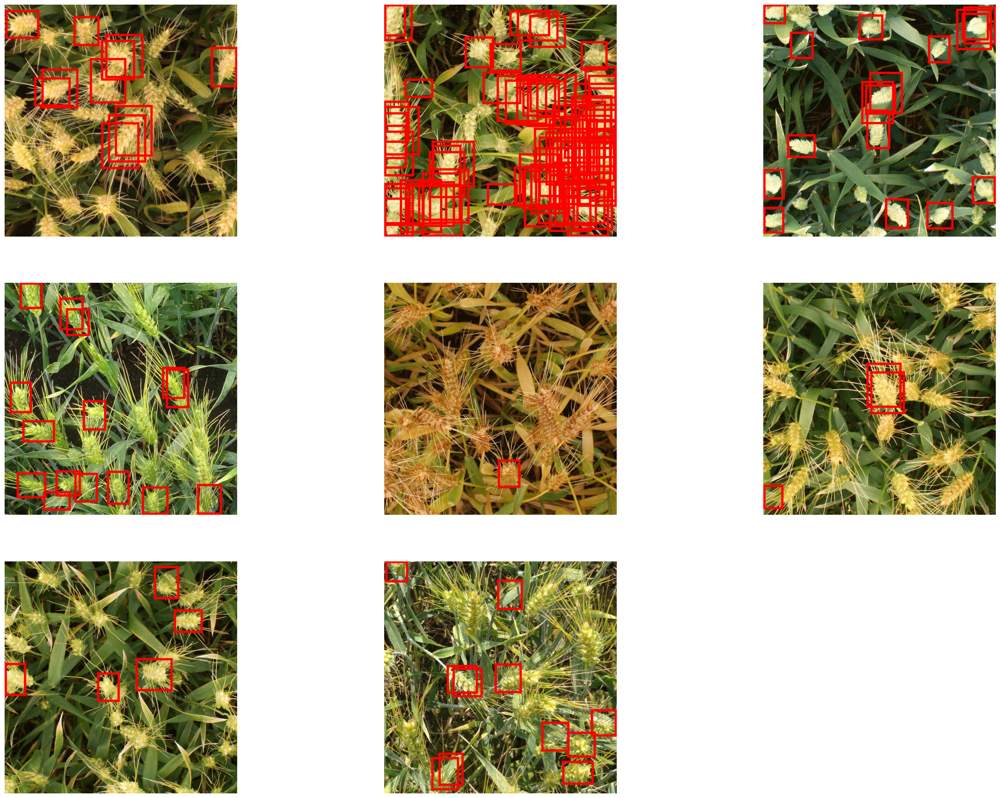

In [66]:
display_preds_with_box(10)

In [69]:
%cd ../../../
%cd kaggle/working/

submission_df.to_csv('submission.csv', index=False)
submission_df.tail(11)

/
/kaggle/working


,image_id,PredictionString
0,53f253011,0.864571 455.073 485.929 168.25 211.966 0.8516...
1,51b3e36ab,0.997807 854.832 545.787 161.896 235.699 0.997...
2,2fd875eaa,0.958766 873.017 38.874 120.367 121.009 0.9408...
3,aac893a91,0.81705 344.355 519.852 103.039 133.145 0.8124...
4,796707dd7,0.531807 500.928 780.332 99.066 125.123
5,cc3532ff6,0.709138 471.06 392.704 152.01 187.333 0.69366...
6,348a992bb,0.789462 577.955 428.9 161.122 144.555 0.65853...
7,51f1be19e,0.830144 5.57 0.0 100.185 94.871 0.771765 910....
0,f5a1f0358,
1,cb8d261a3,


In [70]:
# !rm -rf dataset/
# !rm -rf runs/
# !rm -rf wandb/
# !rm dataset.yaml

In [71]:
!pip install ultralytics

In [ ]:
!yolo detect val data='/kaggle/input/yaml-file/GlobalWheat2020.yml' model=yolov8n.pt

In [84]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n.pt')  # load an official model
# model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')  # load an official model
model = YOLO('/kaggle/working/runs/detect/sgd_noaug2/weights/best.pt')  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map    # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps   # a list contains map50-95 of each category

Ultralytics YOLOv8.0.208 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15110MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/working/dataset/labels/valid.cache... 675 images, 0 backgrounds, 0 corrupt: 100%|██████████| 675/675 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 43/43 [01:42<00:00,  2.38s/it]
                   all        675      30043      0.526      0.478      0.478      0.169
                 wheat        675      30043      0.526      0.478      0.478      0.169
Speed: 2.6ms preprocess, 18.8ms inference, 0.0ms loss, 10.9ms postprocess per image
Results saved to runs/detect/val6


array([    0.16858,     0.16858])

In [85]:
# Load a model
model = YOLO('yolov8n.pt')  # load an official model
model = YOLO('/kaggle/working/runs/detect/adam_aug2/weights/best.pt')  # load an official model
# model = YOLO('/kaggle/working/runs/detect/sgd_noaug/weights/best.pt')  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map    # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps   # a list contains map50-95 of each category

Ultralytics YOLOv8.0.208 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15110MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/working/dataset/labels/valid.cache... 675 images, 0 backgrounds, 0 corrupt: 100%|██████████| 675/675 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 43/43 [02:37<00:00,  3.66s/it]
                   all        675      30043      0.694      0.617      0.676       0.28
                 wheat        675      30043      0.694      0.617      0.676       0.28
Speed: 2.7ms preprocess, 18.8ms inference, 0.0ms loss, 10.7ms postprocess per image
Results saved to runs/detect/val7


array([     0.2802,      0.2802])

In [86]:
# Load a model
model = YOLO('yolov8n.pt')  # load an official model
model = YOLO('/kaggle/working/runs/detect/auto_default2/weights/best.pt')  # load an official model
# model = YOLO('/kaggle/working/runs/detect/sgd_noaug/weights/best.pt')  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map    # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps   # a list contains map50-95 of each category

Ultralytics YOLOv8.0.208 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15110MiB)
YOLOv8n summary (fused): 168 layers, 3006038 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /kaggle/working/dataset/labels/valid.cache... 675 images, 0 backgrounds, 0 corrupt: 100%|██████████| 675/675 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 43/43 [02:37<00:00,  3.66s/it]
                   all        675      30043      0.694      0.617      0.676       0.28
                 wheat        675      30043      0.694      0.617      0.676       0.28
Speed: 2.3ms preprocess, 18.8ms inference, 0.0ms loss, 10.8ms postprocess per image
Results saved to runs/detect/val8


array([     0.2802,      0.2802])